In [1]:
import os
import math
import sys
sys.path.append('../../')

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np
from scipy.ndimage.filters import gaussian_filter



import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
import matplotlib.image as mpimg
import matplotlib.patches as patches


from PIL import Image
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio
import torch
import torch.nn as nn
import torch.nn.functional as F

from src.features.distort_images import distort_image
from src.utils import ycbcr2rgb
from src.models.evaluate_models import evaluate_model

device = torch.device("cuda:3" if torch.cuda.is_available() else "cpu")
SR_FACTOR = 3

train_pixel_mean = 0.43411854967058106
train_pixel_std = 0.23247274722791464

In [2]:
class SRCNN(nn.Module):
    def __init__(self):
        super(SRCNN, self).__init__()
        self.conv1 = nn.Conv2d(1, 64, kernel_size=9, padding=4);
        self.conv2 = nn.Conv2d(64, 32, kernel_size=1, padding=0);
        self.conv3 = nn.Conv2d(32, 1, kernel_size=7, padding=3);

    def forward(self, img):
        out = F.relu(self.conv1(img)) #n_1=64 feature maps
        out = F.relu(self.conv2(out)) #non linear mapping
        out = self.conv3(out)
        return out

In [3]:
SR_model_MSE = SRCNN().to(device)
checkpoint = torch.load('../../checkpoint_SRCNN_w_MSE_higher_lr2.pt')
SR_model_MSE.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

In [4]:
SR_model_MSE

SRCNN(
  (conv1): Conv2d(1, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
  (conv2): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1))
  (conv3): Conv2d(32, 1, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
)

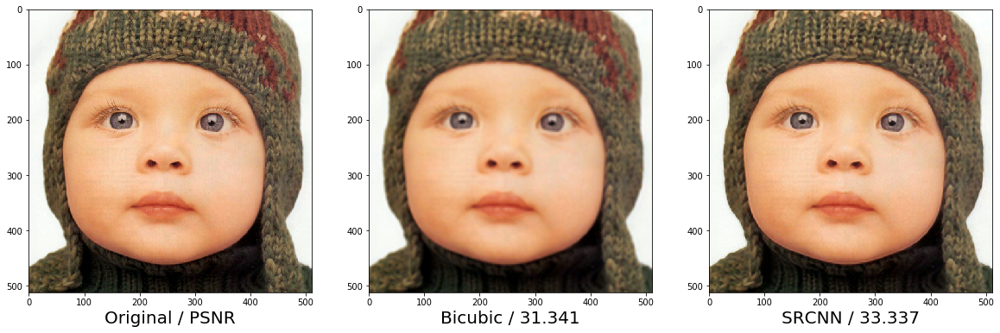

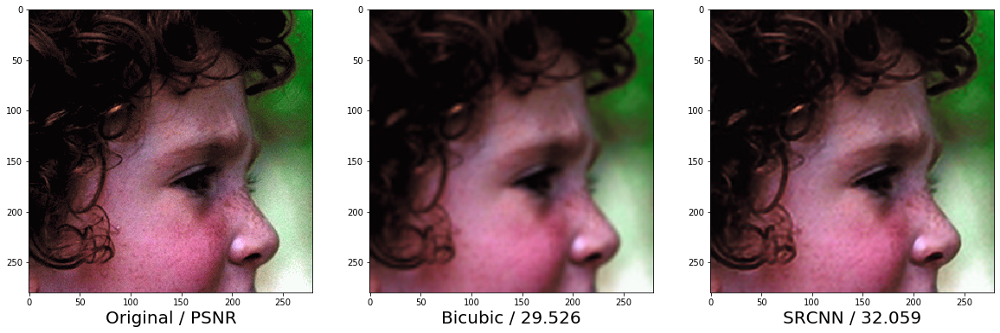

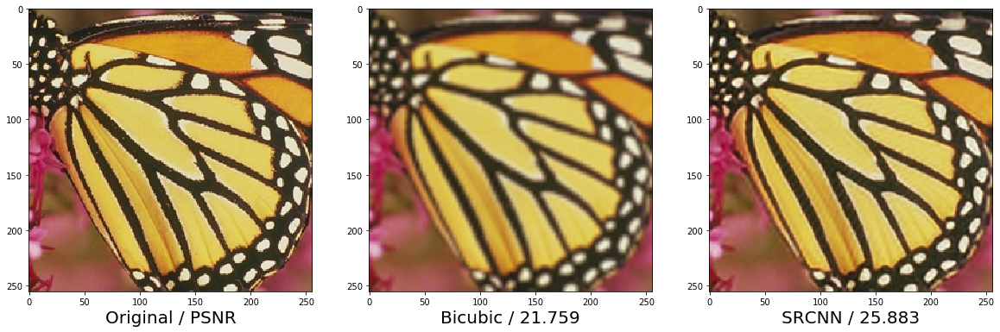

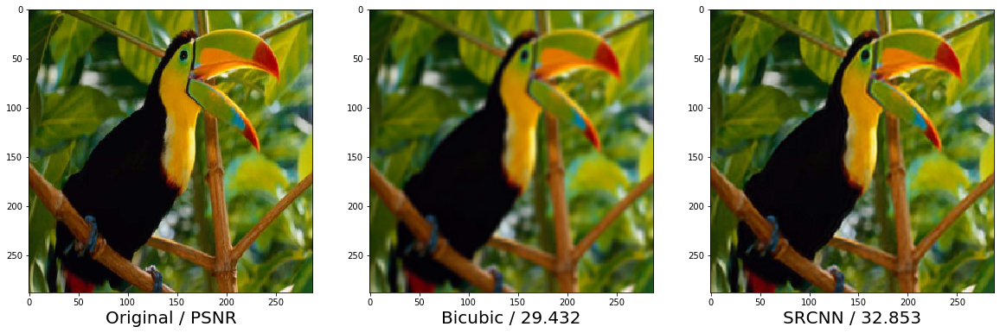

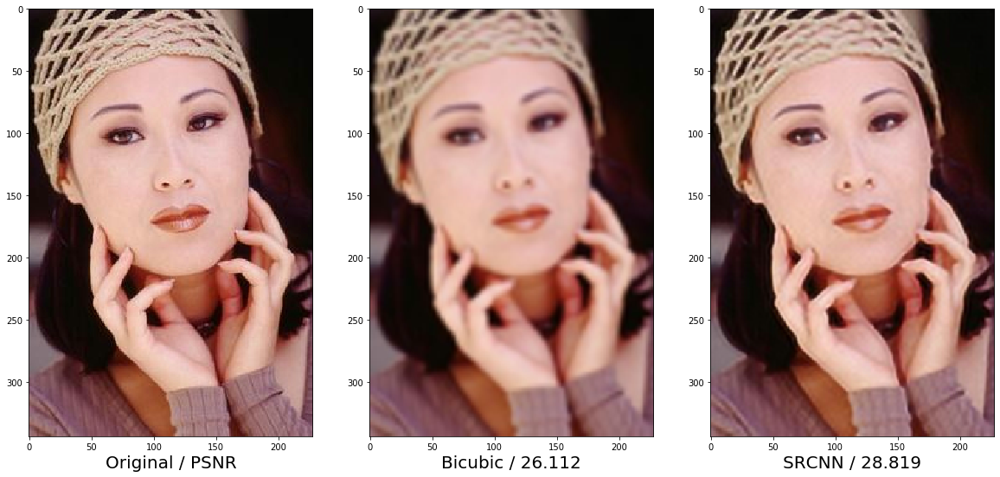

In [22]:
# testing skimage psnr
#v1
test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    im_out_Y = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    f, axarr = plt.subplots(1,3, figsize=(20, 20))
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))
    
    axarr[2].set_xlabel('SRCNN / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    axarr[2].imshow(ycbcr2rgb(im_out_viz))





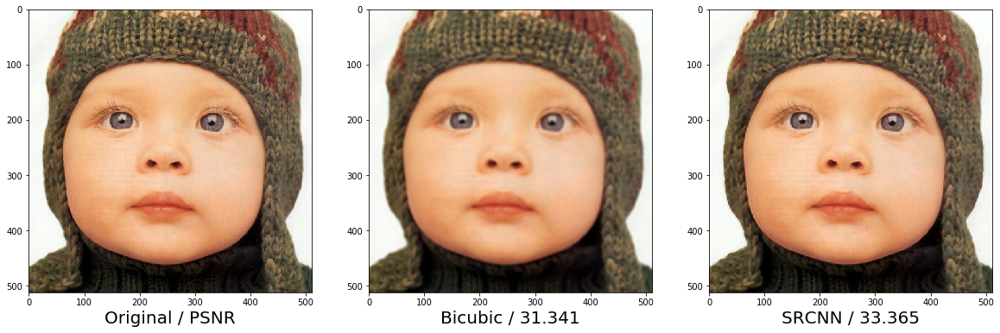

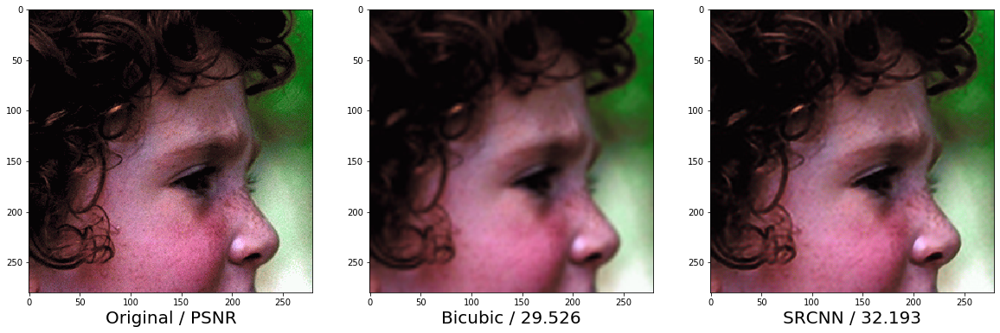

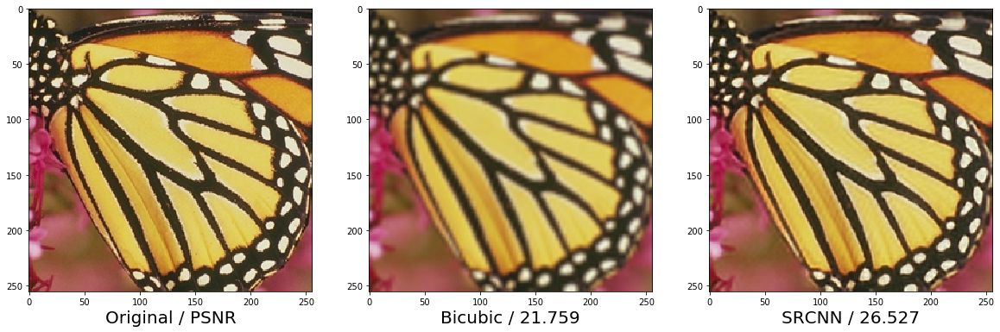

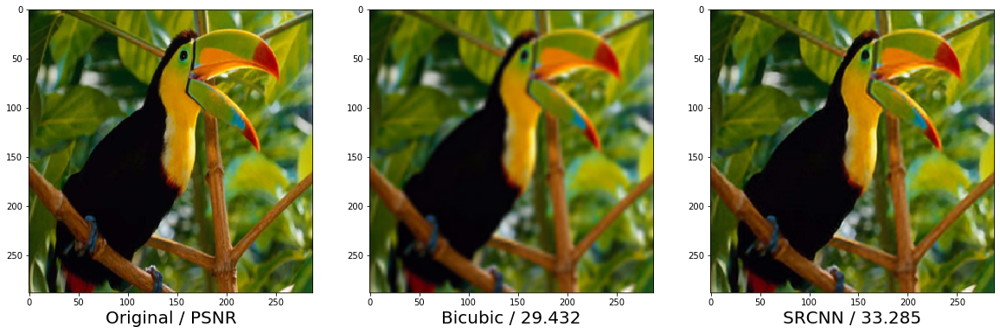

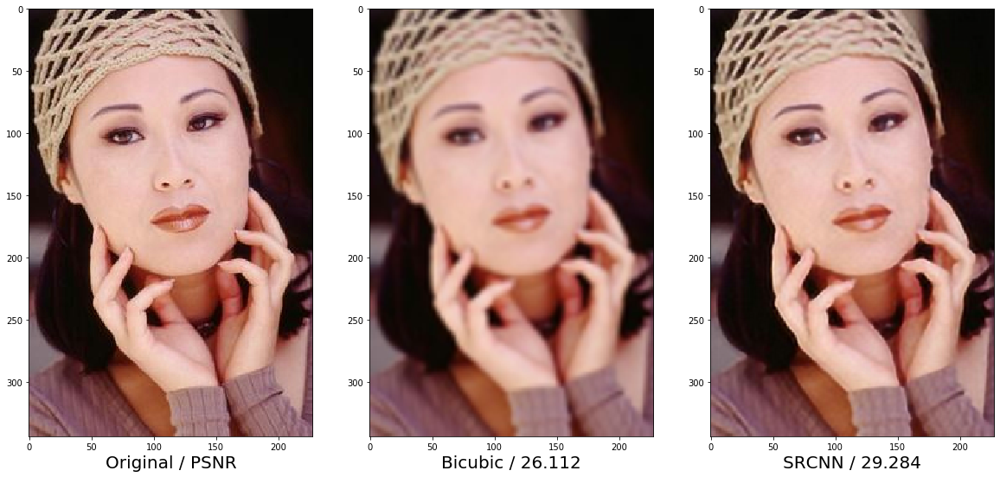

In [5]:
# higher lr 2 version
test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    im_out_Y = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    f, axarr = plt.subplots(1,3, figsize=(20, 20))
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))
    
    axarr[2].set_xlabel('SRCNN / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    axarr[2].imshow(ycbcr2rgb(im_out_viz))





In [5]:
evaluate_model(path='../../data/raw/test_sets/Set5/', 
               model=SR_model_MSE, 
               pixel_mean=train_pixel_mean, 
               pixel_std=train_pixel_std, 
               SR_FACTOR=SR_FACTOR, sigma=1.0)

../../src/models/evaluate_models.py:69: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.
  blur_ssim = compare_ssim(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im), multichannel=True)
../../src/models/evaluate_models.py:70: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.
  sr_ssim = compare_ssim(ycbcr2rgb(im), ycbcr2rgb(im_out_viz), multichannel=True)


(27.633963851033307,
 30.591685937294972,
 0.8232296281335566,
 0.8951898564624617)

In [6]:
evaluate_model(path='../../data/raw/test_sets/Set5/', 
               model=SR_model_MSE, 
               pixel_mean=train_pixel_mean, 
               pixel_std=train_pixel_std, 
               SR_FACTOR=SR_FACTOR, sigma=1.0)

../../src/models/evaluate_models.py:69: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.
  blur_ssim = compare_ssim(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im), multichannel=True)
../../src/models/evaluate_models.py:70: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.
  sr_ssim = compare_ssim(ycbcr2rgb(im), ycbcr2rgb(im_out_viz), multichannel=True)


(27.633963851033307, 30.933062541688134, 0.8232296281335566, 0.901582386203492)

In [7]:
SR_model = SRCNN().to(device)

checkpoint = torch.load('../../checkpoint_SR_with_FDPL_loss_mean.pt')
SR_model.load_state_dict(checkpoint['model_state_dict'])
#optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['val loss']
epoch

9051

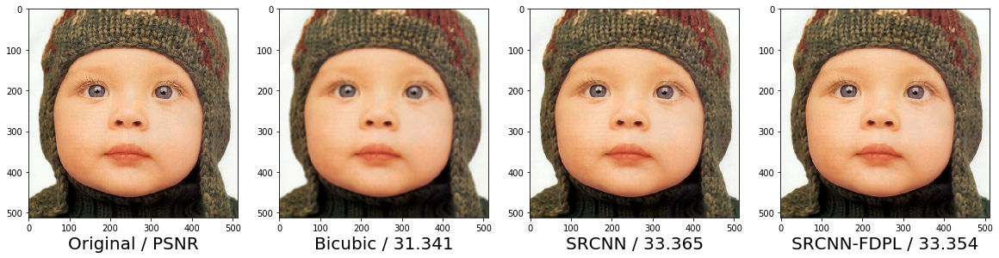

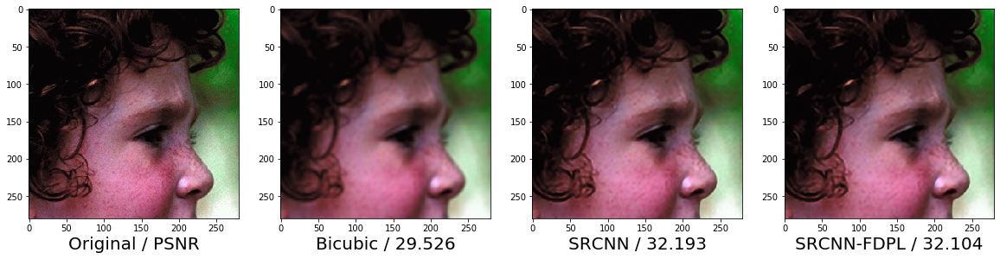

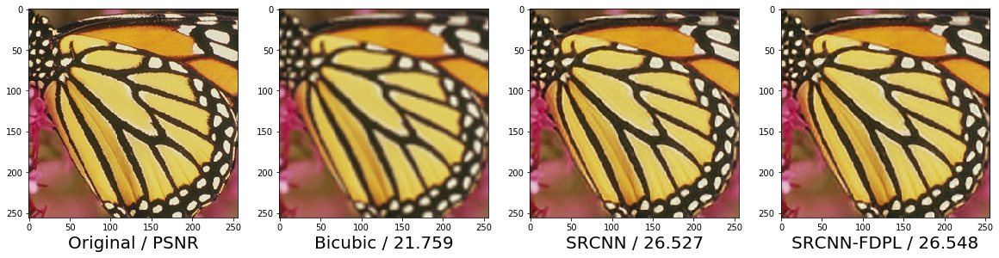

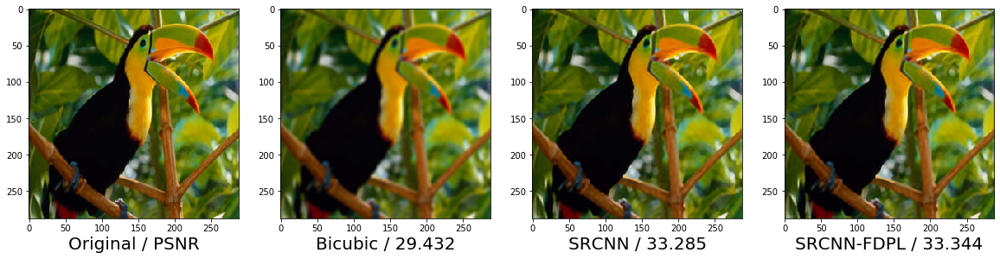

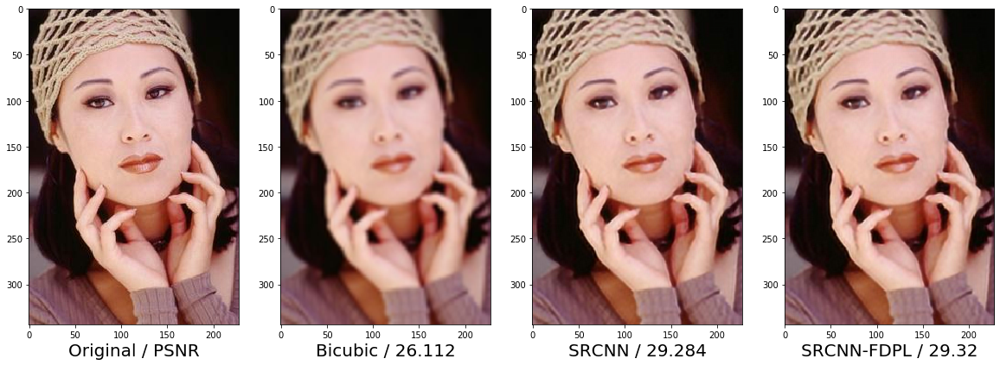

In [9]:
SR_model.conv1.padding = (4,4)
SR_model.conv3.padding = (3,3)
test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    f, axarr = plt.subplots(1,4, figsize=(20, 20))
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))
    
    axarr[2].set_xlabel('SRCNN / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    axarr[2].imshow(ycbcr2rgb(im_out_viz))
    
    axarr[3].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    axarr[3].imshow(ycbcr2rgb(im_out_viz))
    
    #f.savefig('../../example_images/' + test_im[:-4]+'_FDPL.png', bbox_inches='tight', dpi=400)




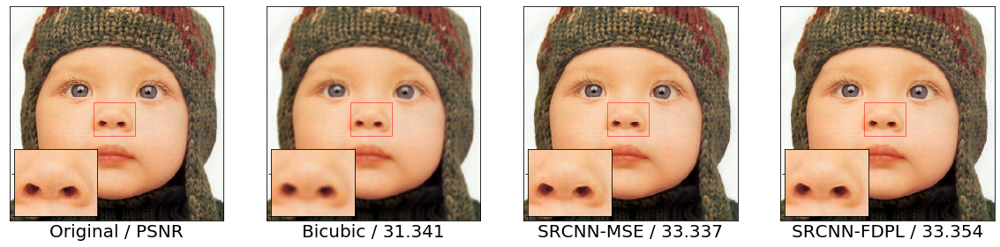

In [14]:

test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names[0:1]:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    fig, axarr = plt.subplots(1,4, figsize=(20, 20))

    fig.patch.set_facecolor('white')
    gs1 = gridspec.GridSpec(1,1)
    gs1.update(wspace=0.02, hspace=0.02)  # set the spacing between axes.
    

    
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    rect1 = patches.Rectangle((200, 200), 100, 80, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 230), 100, 80, linewidth=0.5, ec='red', facecolor='none')

    zoom_in_rec(Image.fromarray(im), axarr[0] ,rect1, cmap='gray')
    axarr[0].set_xticks([])
    axarr[0].set_yticks([])
    axarr[0].add_patch(rect2)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 100, 80, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 230), 100, 80, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec(Image.fromarray(blurred_test_im, 'YCbCr'), axarr[1] ,rect1, cmap='gray')
    axarr[1].set_xticks([])
    axarr[1].set_yticks([])
    axarr[1].add_patch(rect2)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))

    
    axarr[2].set_xlabel('SRCNN-MSE / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 100, 80, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 230), 100, 80, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz_MSE), axarr[2] ,rect1, cmap='gray')
    axarr[2].set_xticks([])
    axarr[2].set_yticks([])
    axarr[2].add_patch(rect2)
    axarr[2].imshow(ycbcr2rgb(im_out_viz_MSE))
    
    axarr[3].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 100, 80, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 230), 100, 80, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz), axarr[3] ,rect1, cmap='gray')
    axarr[3].set_xticks([])
    axarr[3].set_yticks([])
    axarr[3].add_patch(rect2)
    axarr[3].imshow(ycbcr2rgb(im_out_viz))
    
    fig.savefig('../../example_images/' + test_im[:-4]+'_FDPL_mean.png', bbox_inches='tight', dpi=400)


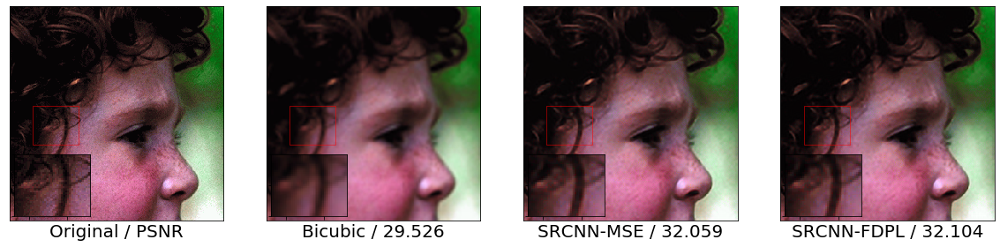

In [15]:

test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names[1:2]:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    fig, axarr = plt.subplots(1,4, figsize=(20, 20))

    fig.patch.set_facecolor('white')
    gs1 = gridspec.GridSpec(1,1)
    gs1.update(wspace=0.02, hspace=0.02)  # set the spacing between axes.
    

    
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    rect1 = patches.Rectangle((40, 100), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((30, 130), 60, 50, linewidth=0.5, ec='red', facecolor='none')

    zoom_in_rec(Image.fromarray(im), axarr[0] ,rect1, cmap='gray')
    axarr[0].set_xticks([])
    axarr[0].set_yticks([])
    axarr[0].add_patch(rect2)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    rect1 = patches.Rectangle((40, 100), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((30, 130), 60, 50, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec(Image.fromarray(blurred_test_im, 'YCbCr'), axarr[1] ,rect1, cmap='gray')
    axarr[1].set_xticks([])
    axarr[1].set_yticks([])
    axarr[1].add_patch(rect2)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))

    
    axarr[2].set_xlabel('SRCNN-MSE / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    rect1 = patches.Rectangle((40, 100), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((30, 130), 60, 50, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz_MSE), axarr[2] ,rect1, cmap='gray')
    axarr[2].set_xticks([])
    axarr[2].set_yticks([])
    axarr[2].add_patch(rect2)
    axarr[2].imshow(ycbcr2rgb(im_out_viz_MSE))
    
    axarr[3].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    rect1 = patches.Rectangle((40, 100), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((30, 130), 60, 50, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz), axarr[3] ,rect1, cmap='gray')
    axarr[3].set_xticks([])
    axarr[3].set_yticks([])
    axarr[3].add_patch(rect2)
    axarr[3].imshow(ycbcr2rgb(im_out_viz))
    
    fig.savefig('../../example_images/' + test_im[:-4]+'_FDPL_mean.png', bbox_inches='tight', dpi=400)


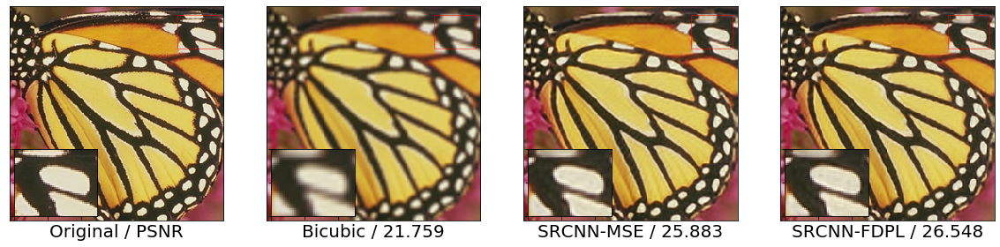

In [16]:

test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names[2:3]:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    fig, axarr = plt.subplots(1,4, figsize=(20, 20))

    fig.patch.set_facecolor('white')
    gs1 = gridspec.GridSpec(1,1)
    gs1.update(wspace=0.02, hspace=0.02)  # set the spacing between axes.
    

    
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    rect1 = patches.Rectangle((200, 200), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 10), 50, 40, linewidth=0.5, ec='red', facecolor='none')

    zoom_in_rec(Image.fromarray(im), axarr[0] ,rect1, cmap='gray')
    axarr[0].set_xticks([])
    axarr[0].set_yticks([])
    axarr[0].add_patch(rect2)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 10), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec(Image.fromarray(blurred_test_im, 'YCbCr'), axarr[1] ,rect1, cmap='gray')
    axarr[1].set_xticks([])
    axarr[1].set_yticks([])
    axarr[1].add_patch(rect2)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))

    
    axarr[2].set_xlabel('SRCNN-MSE / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 10), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz_MSE), axarr[2] ,rect1, cmap='gray')
    axarr[2].set_xticks([])
    axarr[2].set_yticks([])
    axarr[2].add_patch(rect2)
    axarr[2].imshow(ycbcr2rgb(im_out_viz_MSE))
    
    axarr[3].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 10), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz), axarr[3] ,rect1, cmap='gray')
    axarr[3].set_xticks([])
    axarr[3].set_yticks([])
    axarr[3].add_patch(rect2)
    axarr[3].imshow(ycbcr2rgb(im_out_viz))
    
    fig.savefig('../../example_images/' + test_im[:-4]+'_FDPL_mean.png', bbox_inches='tight', dpi=400)


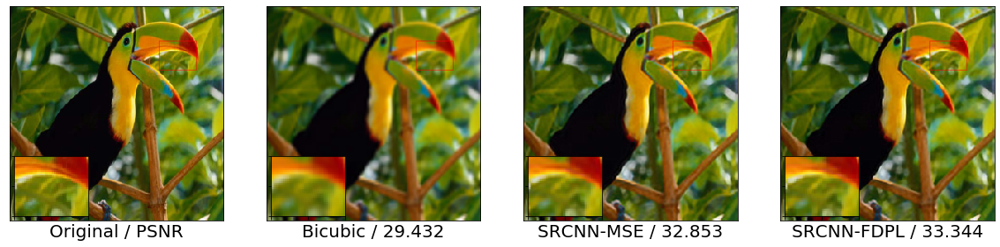

In [17]:

test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names[3:4]:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    fig, axarr = plt.subplots(1,4, figsize=(20, 20))

    fig.patch.set_facecolor('white')
    gs1 = gridspec.GridSpec(1,1)
    gs1.update(wspace=0.02, hspace=0.02)  # set the spacing between axes.
    

    
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    rect1 = patches.Rectangle((200, 200), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 45), 50, 40, linewidth=0.5, ec='red', facecolor='none')

    zoom_in_rec(Image.fromarray(im), axarr[0] ,rect1, cmap='gray')
    axarr[0].set_xticks([])
    axarr[0].set_yticks([])
    axarr[0].add_patch(rect2)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 45), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec(Image.fromarray(blurred_test_im, 'YCbCr'), axarr[1] ,rect1, cmap='gray')
    axarr[1].set_xticks([])
    axarr[1].set_yticks([])
    axarr[1].add_patch(rect2)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))

    
    axarr[2].set_xlabel('SRCNN-MSE / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 45), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz_MSE), axarr[2] ,rect1, cmap='gray')
    axarr[2].set_xticks([])
    axarr[2].set_yticks([])
    axarr[2].add_patch(rect2)
    axarr[2].imshow(ycbcr2rgb(im_out_viz_MSE))
    
    axarr[3].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    rect1 = patches.Rectangle((200, 200), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((200, 45), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz), axarr[3] ,rect1, cmap='gray')
    axarr[3].set_xticks([])
    axarr[3].set_yticks([])
    axarr[3].add_patch(rect2)
    axarr[3].imshow(ycbcr2rgb(im_out_viz))
    
    fig.savefig('../../example_images/' + test_im[:-4]+'_FDPL_mean.png', bbox_inches='tight', dpi=400)


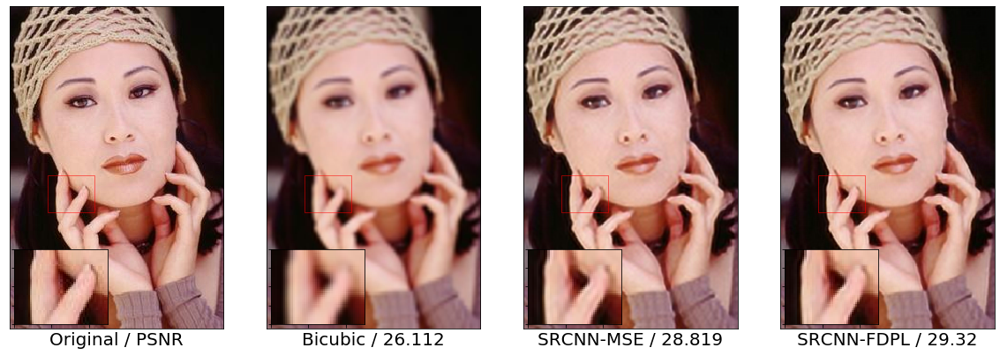

In [18]:

test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names[4:5]:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    fig, axarr = plt.subplots(1,4, figsize=(20, 20))

    fig.patch.set_facecolor('white')
    gs1 = gridspec.GridSpec(1,1)
    gs1.update(wspace=0.02, hspace=0.02)  # set the spacing between axes.
    

    
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    rect1 = patches.Rectangle((40, 120), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((40, 180), 50, 40, linewidth=0.5, ec='red', facecolor='none')

    zoom_in_rec(Image.fromarray(im), axarr[0] ,rect1, cmap='gray')
    axarr[0].set_xticks([])
    axarr[0].set_yticks([])
    axarr[0].add_patch(rect2)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    rect1 = patches.Rectangle((40, 120), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((40, 180), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec(Image.fromarray(blurred_test_im, 'YCbCr'), axarr[1] ,rect1, cmap='gray')
    axarr[1].set_xticks([])
    axarr[1].set_yticks([])
    axarr[1].add_patch(rect2)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))

    
    axarr[2].set_xlabel('SRCNN-MSE / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    rect1 = patches.Rectangle((40, 120), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((40, 180), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz_MSE), axarr[2] ,rect1, cmap='gray')
    axarr[2].set_xticks([])
    axarr[2].set_yticks([])
    axarr[2].add_patch(rect2)
    axarr[2].imshow(ycbcr2rgb(im_out_viz_MSE))
    
    axarr[3].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    rect1 = patches.Rectangle((40, 120), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    rect2 = patches.Rectangle((40, 180), 50, 40, linewidth=0.5, ec='red', facecolor='none')
    zoom_in_rec2(ycbcr2rgb(im_out_viz), axarr[3] ,rect1, cmap='gray')
    axarr[3].set_xticks([])
    axarr[3].set_yticks([])
    axarr[3].add_patch(rect2)
    axarr[3].imshow(ycbcr2rgb(im_out_viz))
    
    fig.savefig('../../example_images/' + test_im[:-4]+'_FDPL_mean.png', bbox_inches='tight', dpi=400)


In [13]:
# source: https://stackoverflow.com/questions/47544242/how-to-fix-a-rotated-output-in-zoom-in-region-in-image
def zoom_in_rec(input, ax, rect, cmap):
    axins = zoomed_inset_axes(ax, 2, loc=3)  
    x1, x2, y1, y2 = rect.get_x(), rect.get_x()+rect.get_width(),rect.get_y(), rect.get_y()+rect.get_height() # specify the limits
    axins.set_xlim(x1, x2)  # apply the x-limits
    axins.set_ylim(y1, y2)  # apply the y-limits
    #mark_inset(ax, axins, loc1=1, loc2=2, fc="none", ec='red',lw=1.0, ls=':')
    plt.yticks(visible=False)
    plt.xticks(visible=False)
    rot = np.flipud(input)
    axins.imshow(Image.fromarray(rot, 'YCbCr'))

def zoom_in_rec2(input, ax, rect, cmap):
    axins = zoomed_inset_axes(ax, 2, loc=3)  
    x1, x2, y1, y2 = rect.get_x(), rect.get_x()+rect.get_width(),rect.get_y(), rect.get_y()+rect.get_height() # specify the limits
    axins.set_xlim(x1, x2)  # apply the x-limits
    axins.set_ylim(y1, y2)  # apply the y-limits
    #mark_inset(ax, axins, loc1=1, loc2=2, fc="none", ec='red',lw=1.0, ls=':')
    #zoomed_inset_axes(ax, zoom=0.5)
    plt.yticks(visible=False)
    plt.xticks(visible=False)
    rot = np.flipud(input)
    axins.imshow(rot)

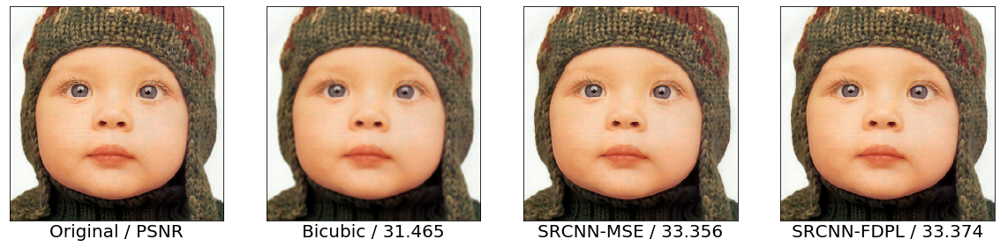

In [153]:
SR_model.conv1.padding = (4,4)
SR_model.conv3.padding = (3,3)
test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names[0:1]:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    fig, axarr = plt.subplots(1,4, figsize=(20, 20))


    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    axarr[0].set_xticks([])
    axarr[0].set_yticks([])
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(psnr(im[:,:,0], blurred_test_im[:,:,0]),3)), fontsize=20)
    axarr[1].set_xticks([])
    axarr[1].set_yticks([])
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))

    axarr[2].set_xlabel('SRCNN-MSE / ' + str(np.around(psnr(im[:,:,0], im_out_viz_MSE[:,:,0]),3)), fontsize=20)
    axarr[2].set_xticks([])
    axarr[2].set_yticks([])
    axarr[2].imshow(ycbcr2rgb(im_out_viz_MSE))
    
    axarr[3].set_xlabel('SRCNN-FDPL / ' + str(np.around(psnr(im[:,:,0], im_out_viz[:,:,0]),3)), fontsize=20)
    axarr[3].set_xticks([])
    axarr[3].set_yticks([])
    axarr[3].imshow(ycbcr2rgb(im_out_viz))
    
    #f.savefig('../../example_images/' + test_im[:-4]+'_FDPL_mean.png', bbox_inches='tight', dpi=400)


In [ ]:
if __name__ == "__main__":
    img = mpimg.imread('lena.bmp')
    #Plot
    fig = plt.figure(figsize=(128,128))
    fig.patch.set_facecolor('white')
    gs1 = gridspec.GridSpec(1,1)
    gs1.update(wspace=0.02, hspace=0.02)  # set the spacing between axes.
    ax1 = plt.subplot(gs1[0])
    ax1.imshow(img,cmap='gray')
    rect1 = patches.Rectangle((200, 200), 120, 80, linewidth=3, edgecolor='r', facecolor='none')
    zoom_in_rec(img, ax1,rect1, cmap='gray')
    plt.show()

In [11]:
evaluate_model(path='../../data/raw/test_sets/Set5/', 
               model=SR_model, 
               pixel_mean=train_pixel_mean, 
               pixel_std=train_pixel_std, 
               SR_FACTOR=SR_FACTOR, sigma=1.0)

(27.633963851033307,
 30.939857166479804,
 0.8232296281335566,
 0.9015884103913756)

In [ ]:
(28.01622398391864, 30.906479931318557)


In [2]:
30.906479931318557/ 30.56333376377761

1.0112273801736782

In [12]:
SR_model = SRCNN().to(device)

checkpoint = torch.load('../../checkpoint_SR_with_FDPL_loss_mean_lower_lr.pt')
SR_model.load_state_dict(checkpoint['model_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['val loss']
epoch

128

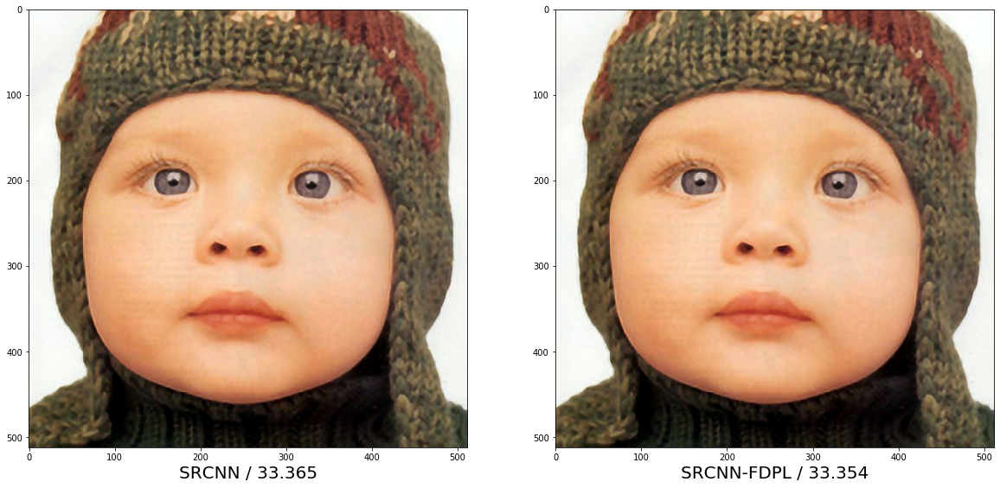

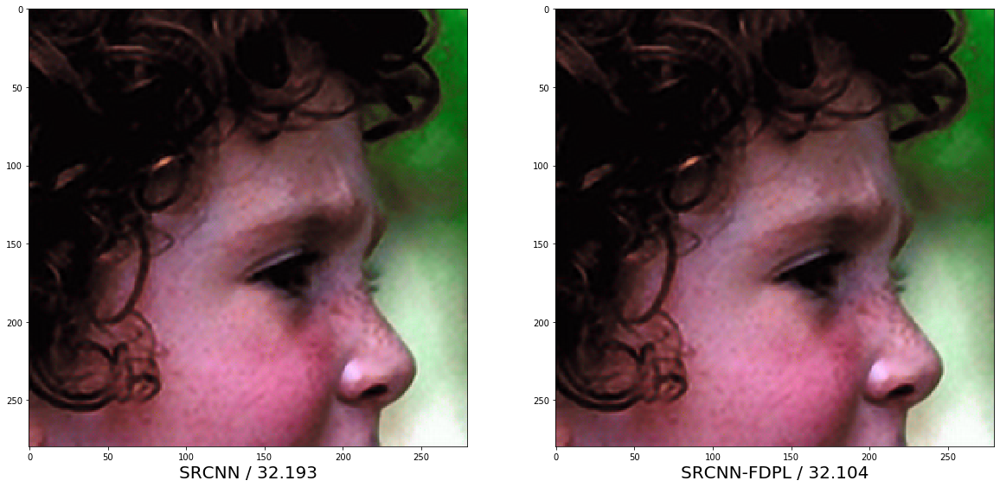

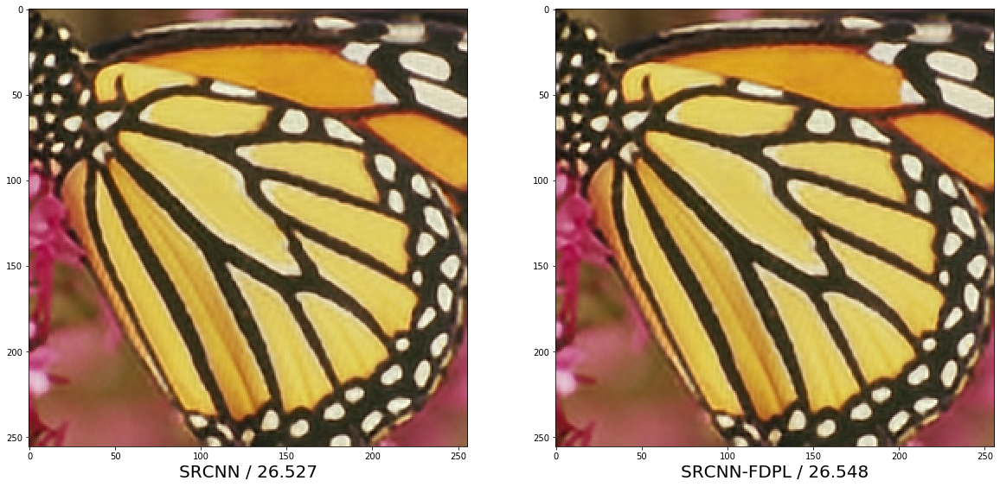

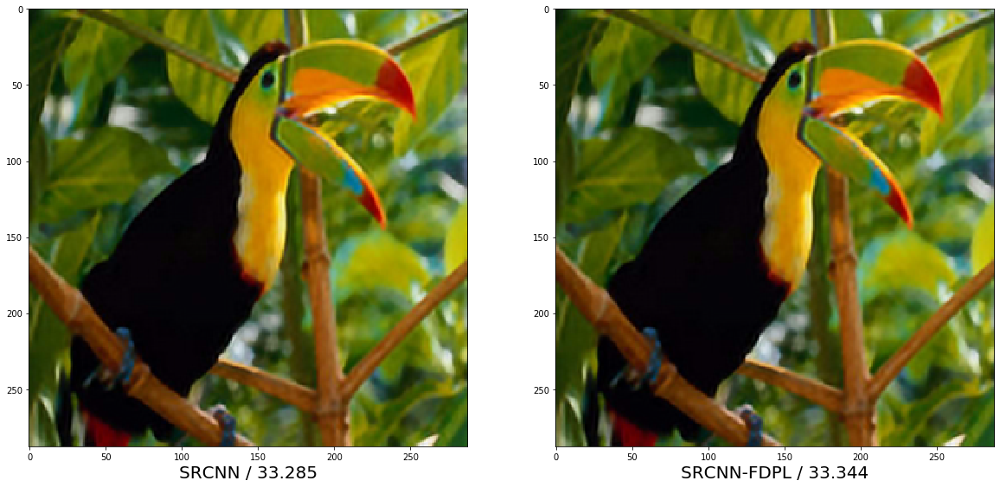

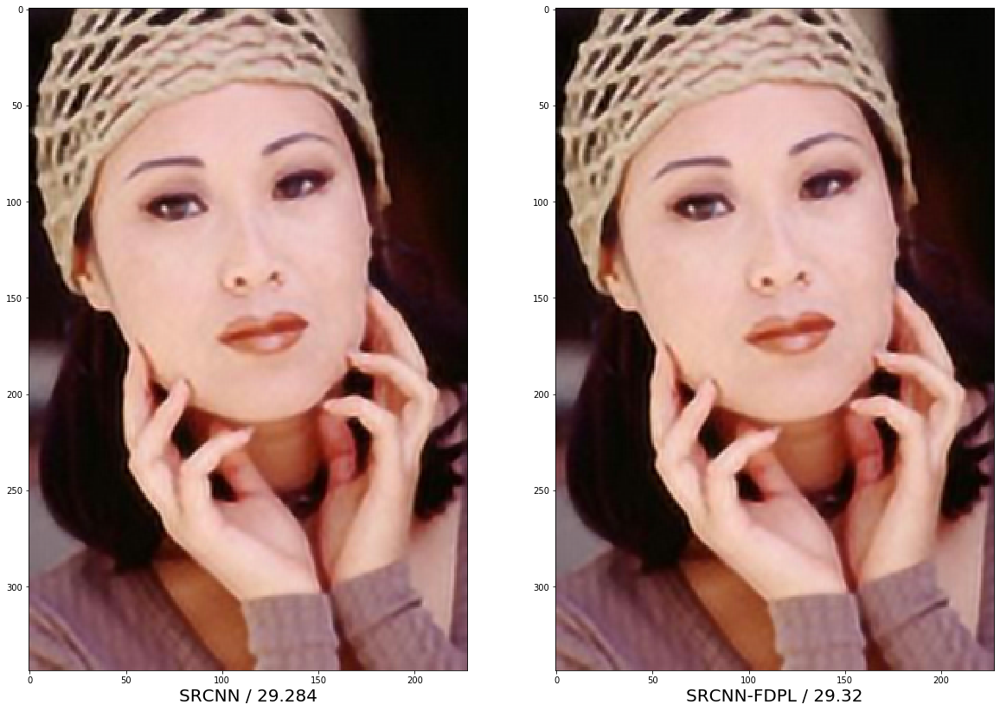

In [10]:
SR_model.conv1.padding = (4,4)
SR_model.conv3.padding = (3,3)
test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    f, axarr = plt.subplots(1,2, figsize=(20, 20))
#     axarr[0].set_xlabel('Original / PSNR', fontsize=20)
#     axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

#     axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
#     axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))
    
    axarr[0].set_xlabel('SRCNN / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    axarr[0].imshow(ycbcr2rgb(im_out_viz))
    
    axarr[1].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    axarr[1].imshow(ycbcr2rgb(im_out_viz))
    
    #f.savefig('../../example_images/' + test_im[:-4]+'_FDPL_Antidiagonal_trasnpose.png', bbox_inches='tight', dpi=400)






In [13]:
evaluate_model(path='../../data/raw/test_sets/Set5/', 
               model=SR_model, 
               pixel_mean=train_pixel_mean, 
               pixel_std=train_pixel_std, 
               SR_FACTOR=SR_FACTOR, sigma=1.0)

(27.633963851033307,
 30.823123345126753,
 0.8232296281335566,
 0.9007601899278714)

In [ ]:
(28.01622398391864, 30.798569203767563)

In [14]:
SR_model = SRCNN().to(device)

checkpoint = torch.load('../../checkpoint_SR_with_FDPL_loss_mean_lower_lr_flipped_weights.pt')
SR_model.load_state_dict(checkpoint['model_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['val loss']
epoch

8146

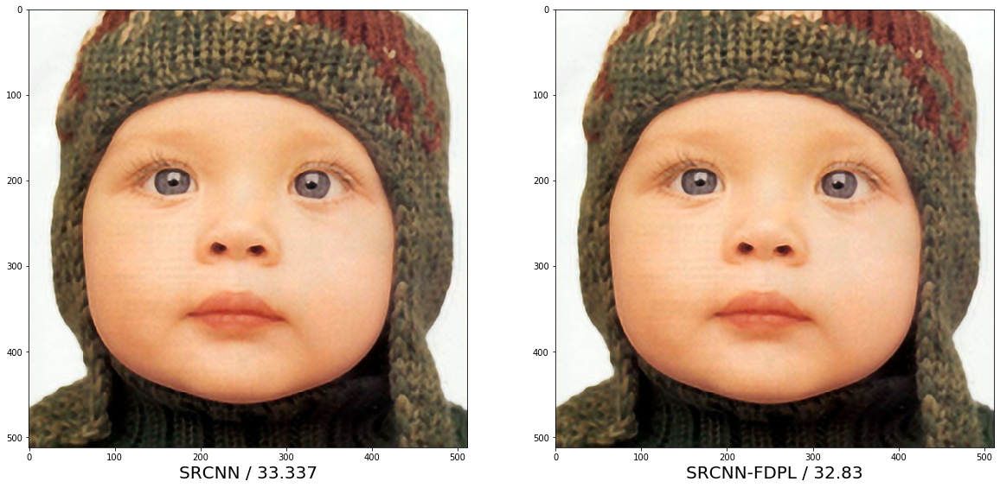

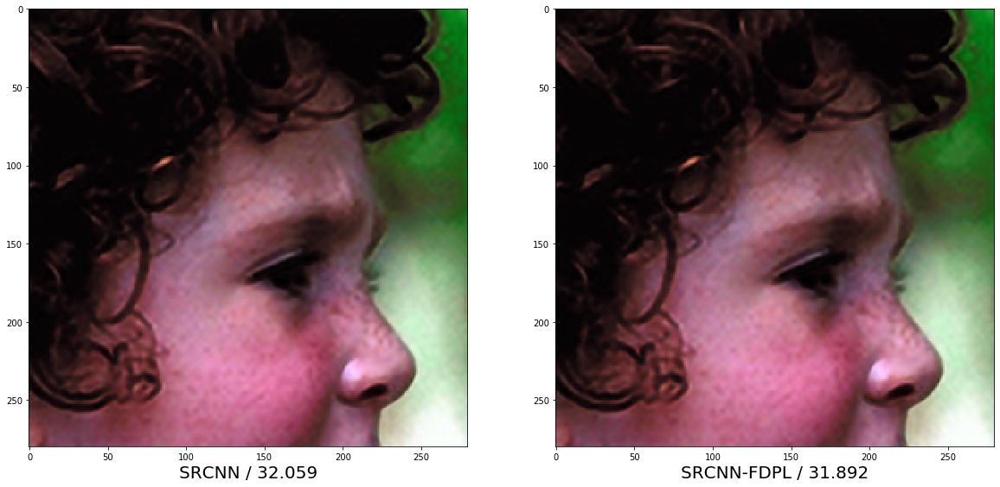

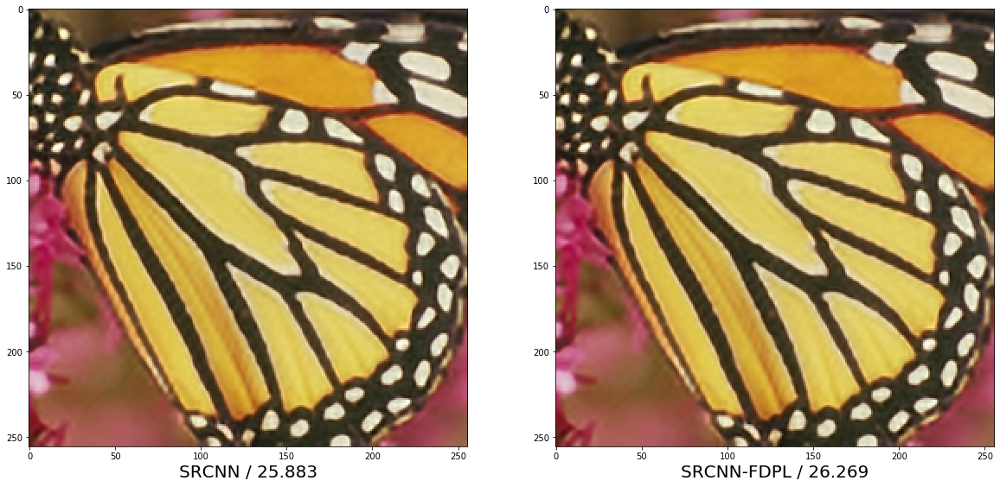

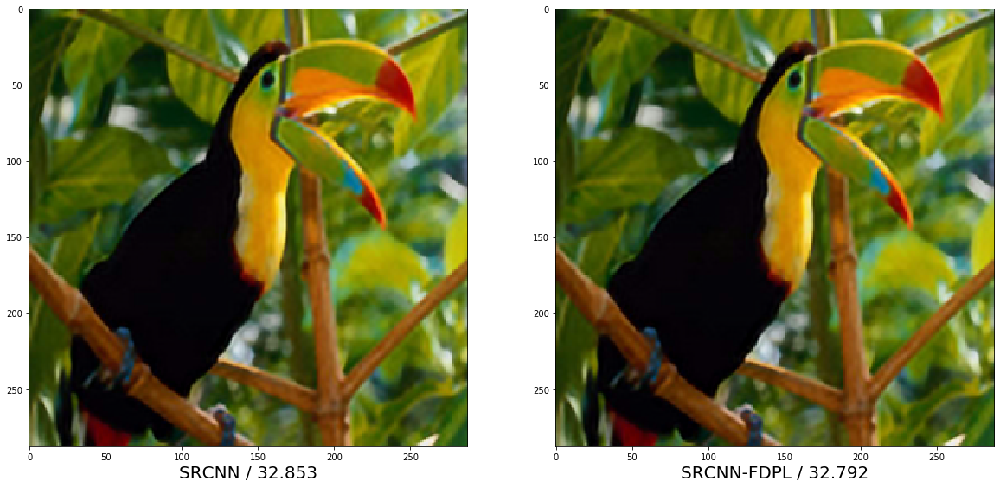

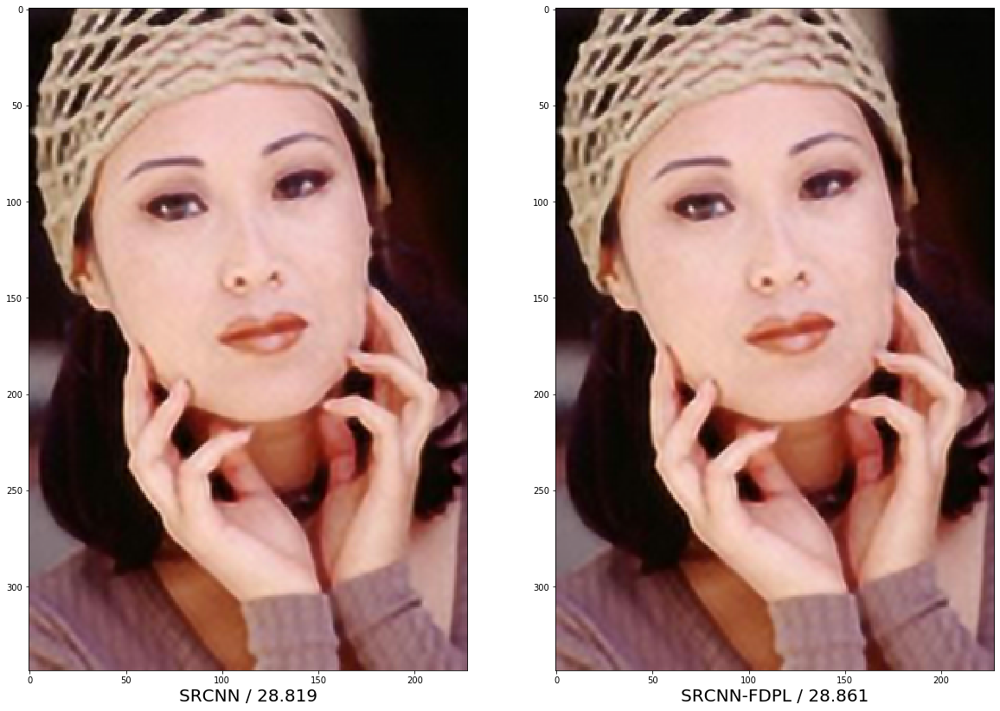

In [26]:
SR_model.conv1.padding = (4,4)
SR_model.conv3.padding = (3,3)
test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    f, axarr = plt.subplots(1,2, figsize=(20, 20))
#     axarr[0].set_xlabel('Original / PSNR', fontsize=20)
#     axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

#     axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
#     axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))
    
    axarr[0].set_xlabel('SRCNN / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    axarr[0].imshow(ycbcr2rgb(im_out_viz))
    
    axarr[1].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    axarr[1].imshow(ycbcr2rgb(im_out_viz))
    
    #f.savefig('../../example_images/' + test_im[:-4]+'_FDPL_Antidiagonal_trasnpose.png', bbox_inches='tight', dpi=400)




In [15]:
evaluate_model(path='../../data/raw/test_sets/Set5/', 
               model=SR_model, 
               pixel_mean=train_pixel_mean, 
               pixel_std=train_pixel_std, 
               SR_FACTOR=SR_FACTOR, sigma=1.0)

(27.633963851033307,
 30.594568998357637,
 0.8232296281335566,
 0.8987567595436767)

## Check visual quality of validation set images and training images

In [16]:
SR_model = SRCNN().to(device)

checkpoint = torch.load('../../checkpoint_SR_with_FDPL_loss_mean.pt')
SR_model.load_state_dict(checkpoint['model_state_dict'])
#optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['val loss']
epoch

9051

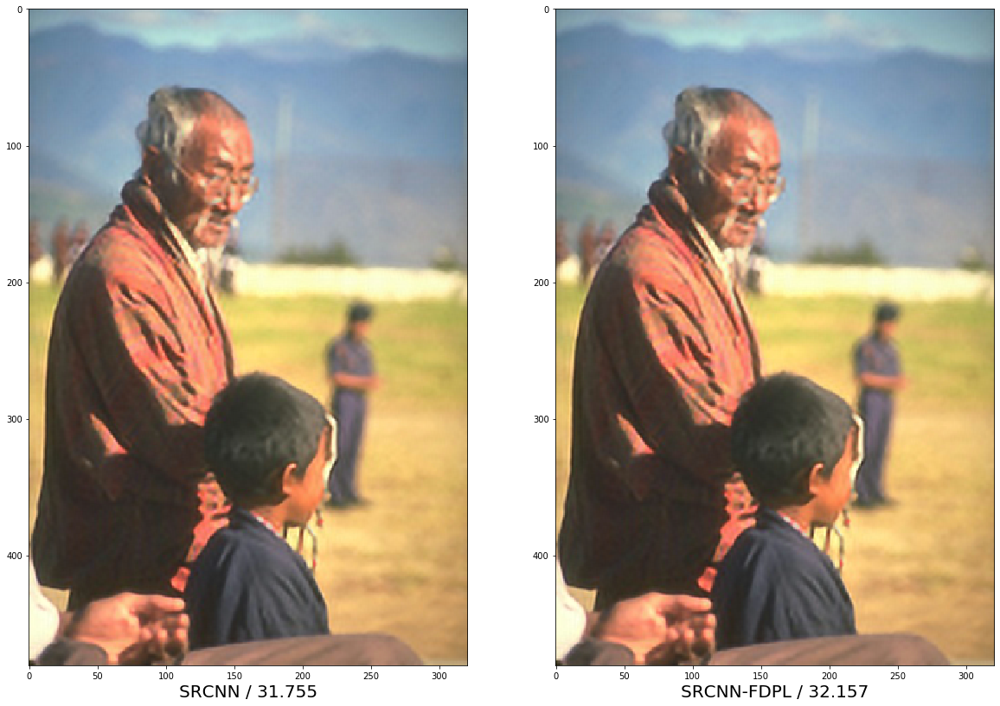

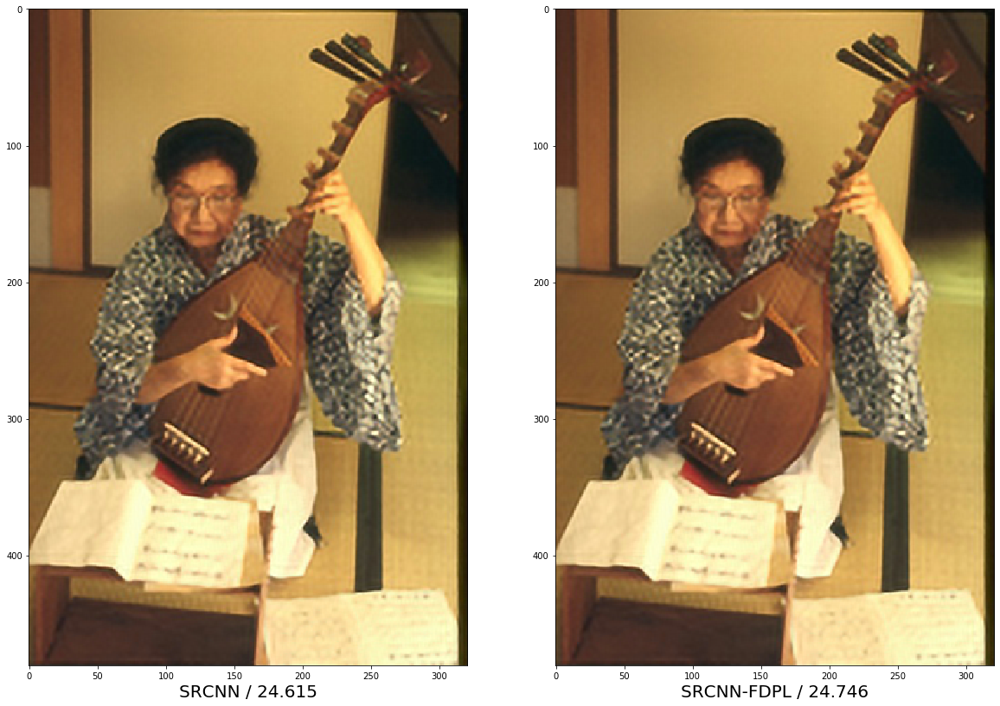

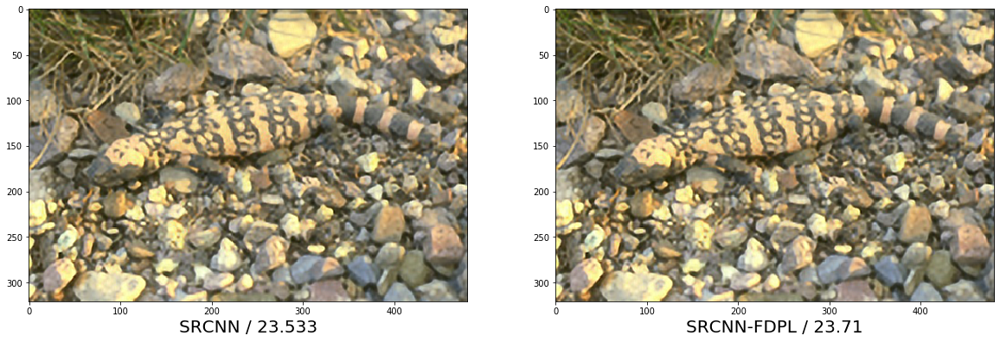

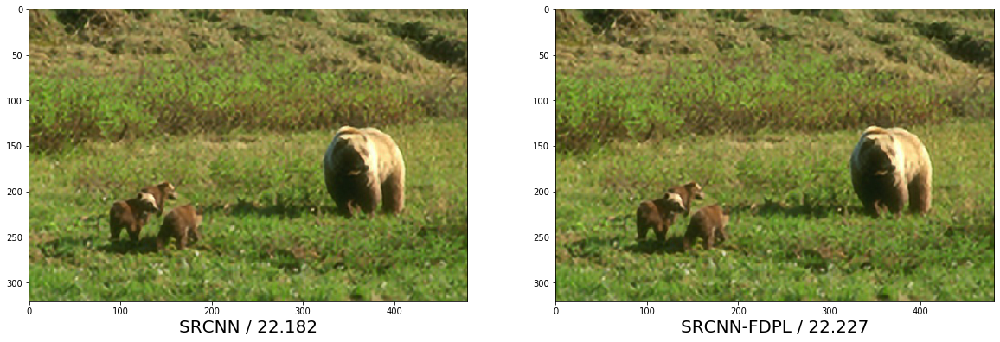

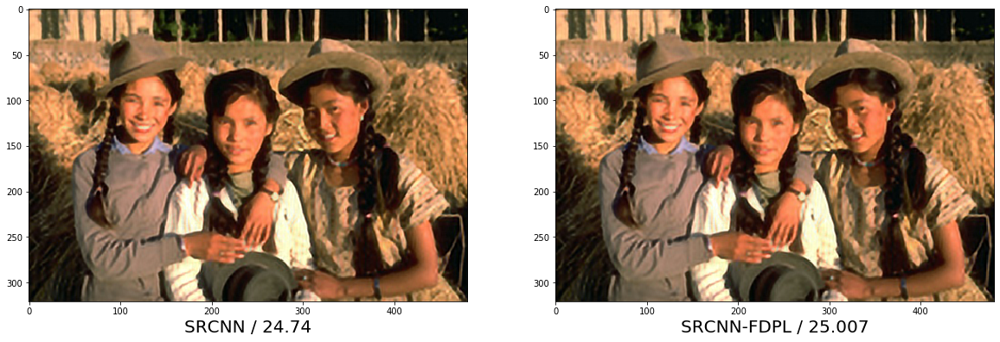

...

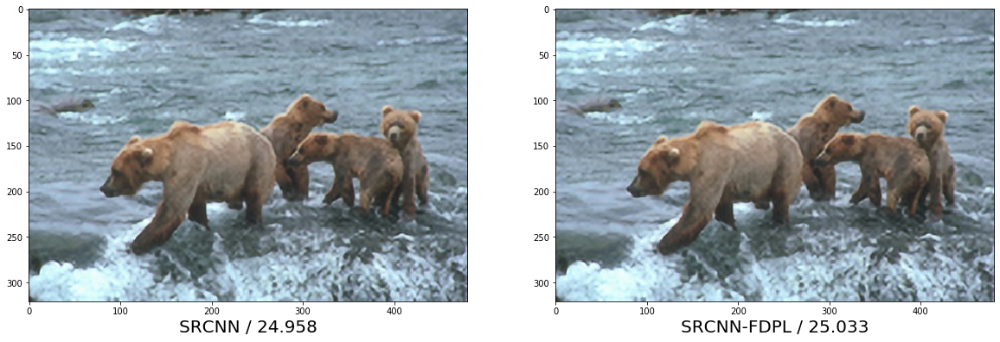

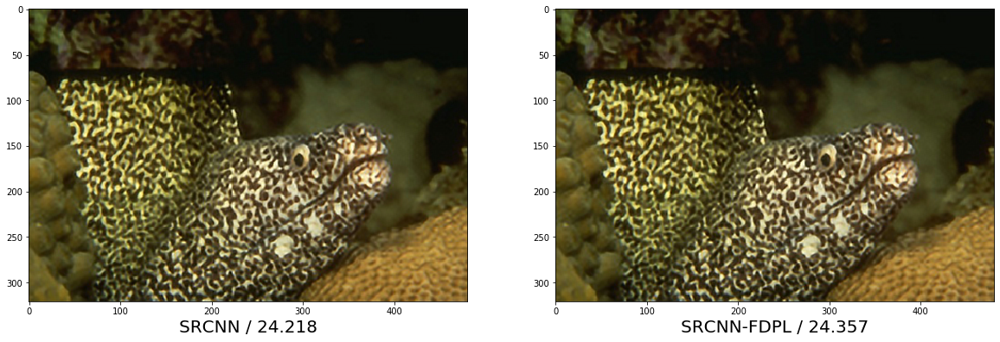

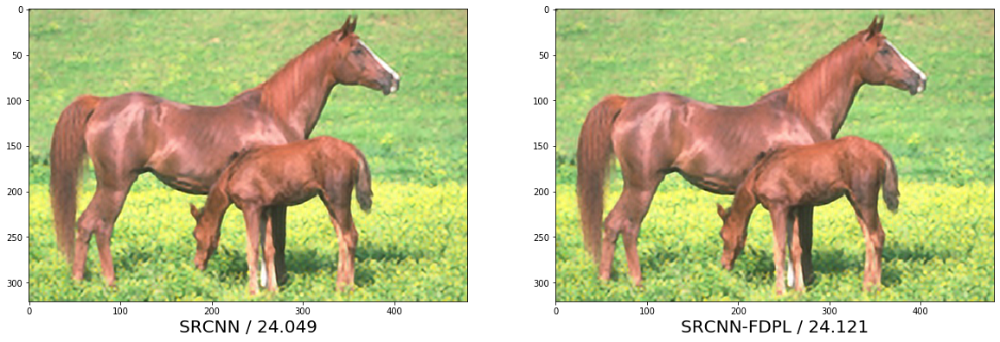

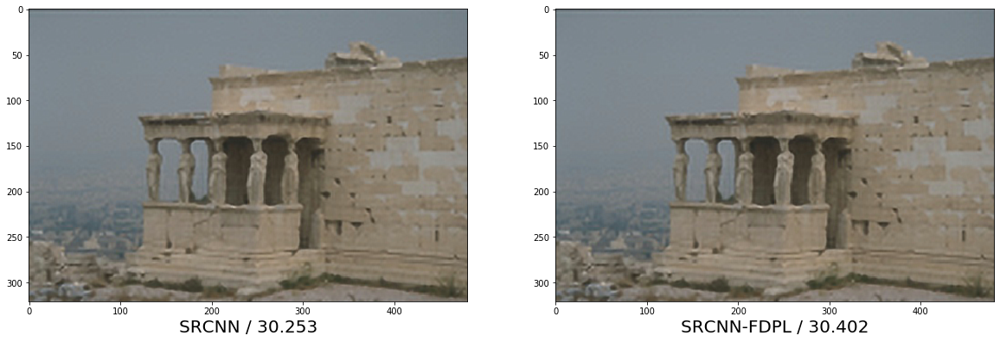

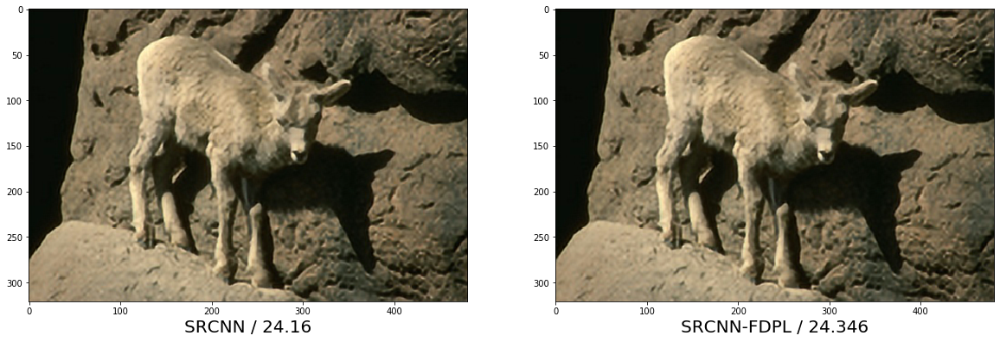

In [18]:
SR_model.conv1.padding = (4,4)
SR_model.conv3.padding = (3,3)
training_img_names = [im for im in os.listdir('../../data/raw/BSDS500/data/images/train/') if im[-4:] == '.jpg']

for test_im in training_img_names[10:30]:
    path = '../../data/raw/BSDS500/data/images/train/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    f, axarr = plt.subplots(1,2, figsize=(20, 20))
#     axarr[0].set_xlabel('Original / PSNR', fontsize=20)
#     axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

#     axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
#     axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))
    
    axarr[0].set_xlabel('SRCNN / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    axarr[0].imshow(ycbcr2rgb(im_out_viz))
    
    axarr[1].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    axarr[1].imshow(ycbcr2rgb(im_out_viz))
    
    #f.savefig('../../example_images/' + test_im[:-4]+'_FDPL_Antidiagonal_trasnpose.png', bbox_inches='tight', dpi=400)




In [5]:
SR_model = SRCNN().to(device)

checkpoint = torch.load('../../checkpoint_SR_with_FDPL_no_diff_matrix.pt')
SR_model.load_state_dict(checkpoint['model_state_dict'])
epoch = checkpoint['epoch']

epoch

2842

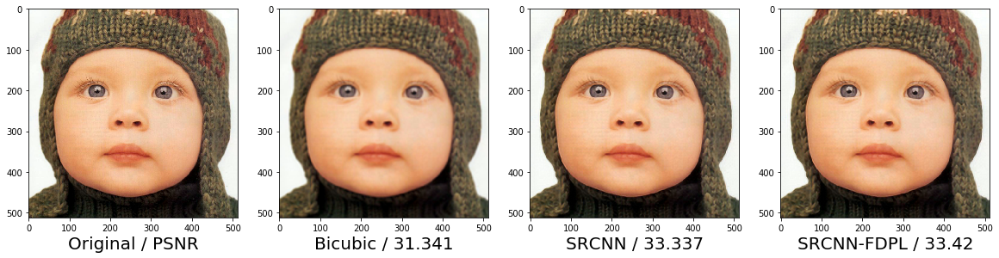

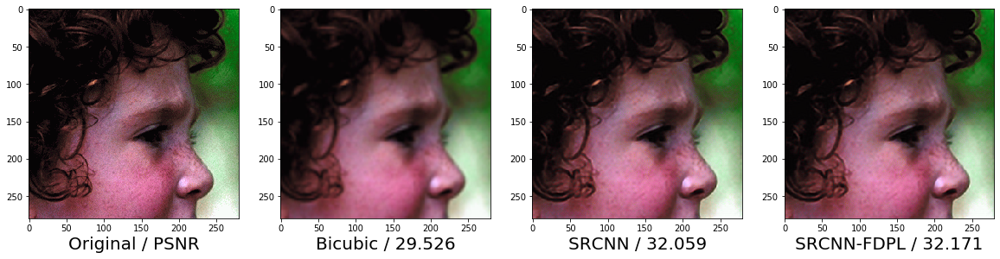

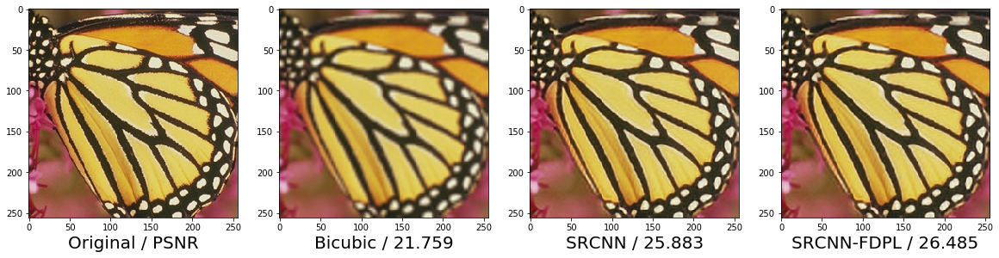

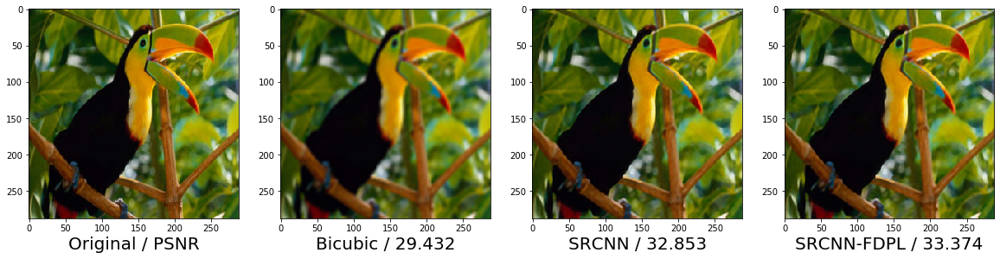

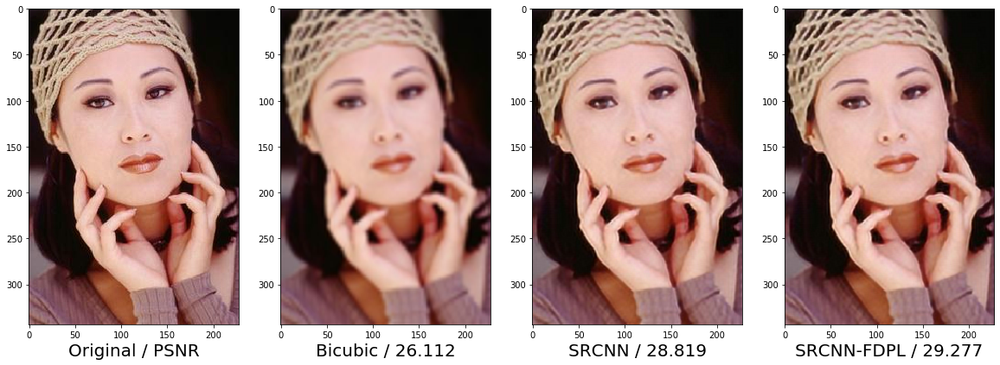

In [6]:
SR_model.conv1.padding = (4,4)
SR_model.conv3.padding = (3,3)
test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    f, axarr = plt.subplots(1,4, figsize=(20, 20))
    axarr[0].set_xlabel('Original / PSNR', fontsize=20)
    axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

    axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
    axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))
    
    axarr[2].set_xlabel('SRCNN / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    axarr[2].imshow(ycbcr2rgb(im_out_viz))
    
    axarr[3].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    axarr[3].imshow(ycbcr2rgb(im_out_viz))
    
    #f.savefig('../../example_images/' + test_im[:-4]+'_FDPL.png', bbox_inches='tight', dpi=400)




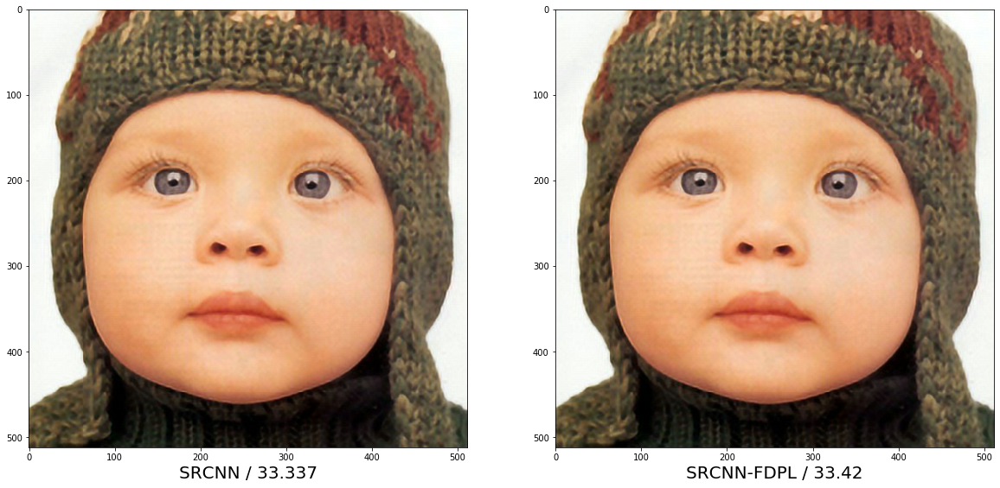

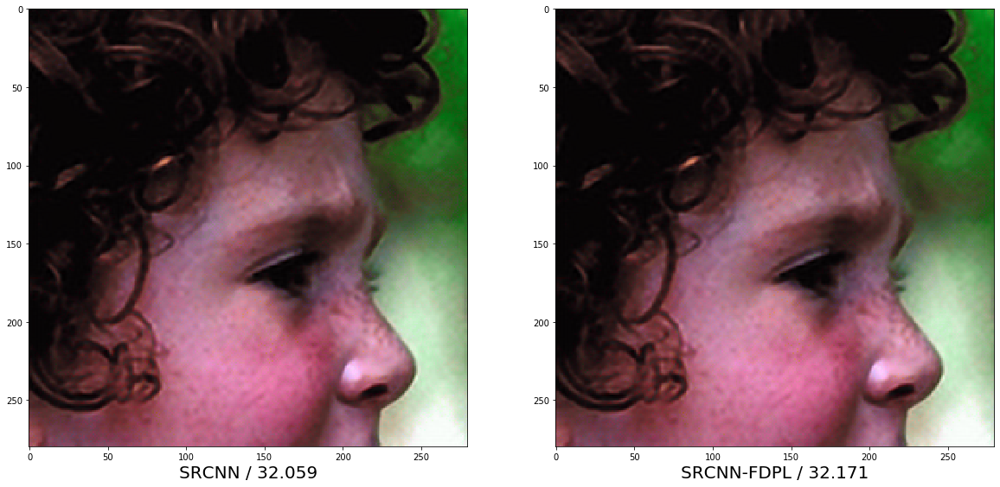

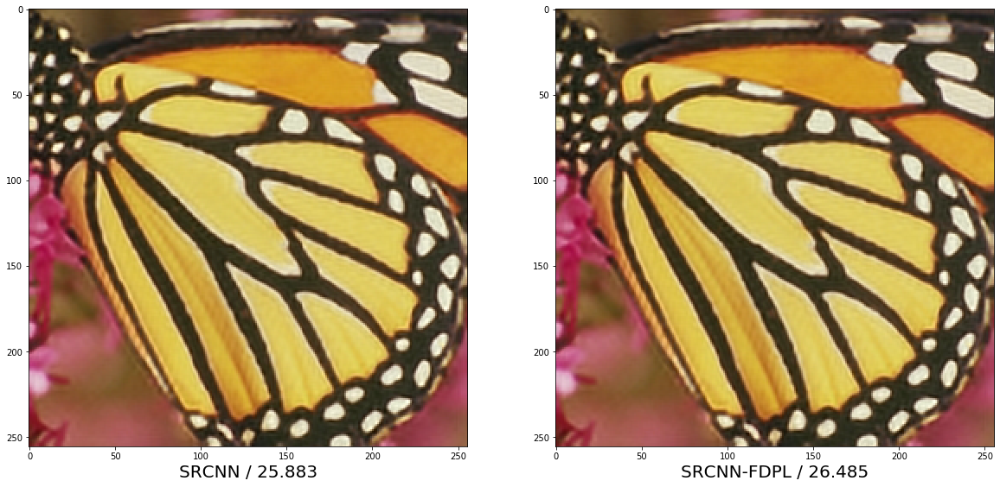

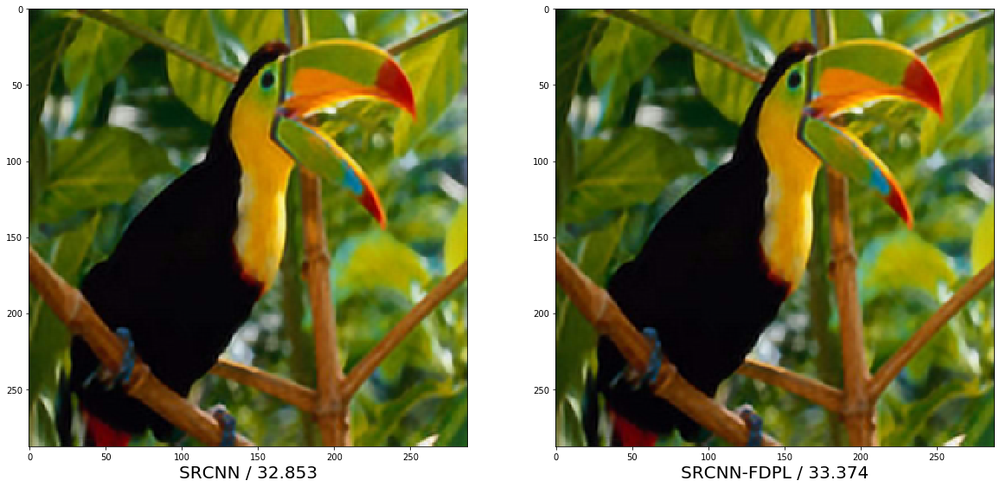

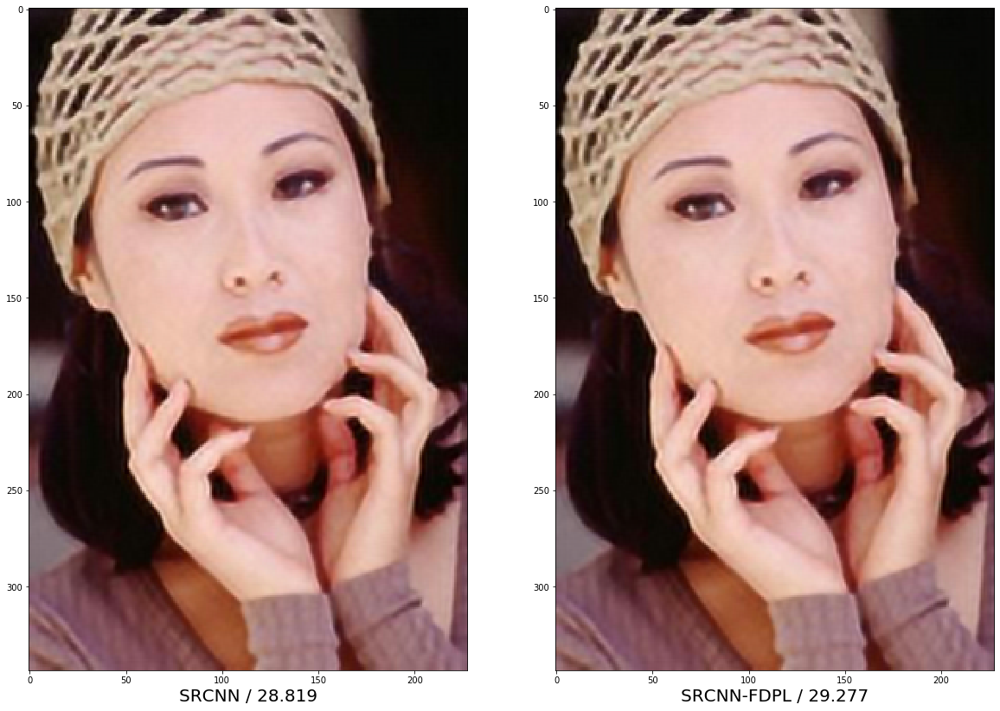

In [7]:
SR_model.conv1.padding = (4,4)
SR_model.conv3.padding = (3,3)
test5_img_names = [im for im in os.listdir('../../data/raw/test_sets/Set5/') if im[-4:] == '.bmp']

for test_im in test5_img_names:
    path = '../../data/raw/test_sets/Set5/' + test_im
    blurred_test_im = distort_image(path=path, factor=SR_FACTOR, sigma=1, blur=True)
    ImageFile = Image.open(path)
    im = np.array(ImageFile.convert('YCbCr')) 
    
    #normalize
    input = blurred_test_im[:,:,0] / 255.0
    #standardize
    input -= train_pixel_mean
    input /= train_pixel_std
    
    #MSE output
    im_out_Y_MSE = SR_model_MSE(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y_MSE = im_out_Y_MSE.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz_MSE = np.zeros((im_out_Y_MSE.shape[0], im_out_Y_MSE.shape[1], 3))
    
    #unstandardize 
    im_out_Y_MSE = (im_out_Y_MSE * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y_MSE *= 255.0

    im_out_viz_MSE[:,:,0] = im_out_Y_MSE
    im_out_viz_MSE[:,:,1] = im[:,:,1]
    im_out_viz_MSE[:,:,2] = im[:,:,2]
    
    
    
    
    
    #FDPL output
    im_out_Y = SR_model(torch.tensor(input, dtype=torch.float).unsqueeze(0).unsqueeze(0).to(device))
    im_out_Y = im_out_Y.detach().squeeze().squeeze().cpu().numpy().astype(np.float)
    im_out_viz = np.zeros((im_out_Y.shape[0], im_out_Y.shape[1], 3))
    
    #unstandardize 
    im_out_Y = (im_out_Y * train_pixel_std) + train_pixel_mean
    
    #un-normalize
    im_out_Y *= 255.0

    im_out_viz[:,:,0] = im_out_Y
    im_out_viz[:,:,1] = im[:,:,1]
    im_out_viz[:,:,2] = im[:,:,2]


    f, axarr = plt.subplots(1,2, figsize=(20, 20))
#     axarr[0].set_xlabel('Original / PSNR', fontsize=20)
#     axarr[0].imshow(Image.fromarray(im, 'YCbCr'))

#     axarr[1].set_xlabel('Bicubic / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(blurred_test_im)),3)), fontsize=20)
#     axarr[1].imshow(Image.fromarray(blurred_test_im, 'YCbCr'))
    
    axarr[0].set_xlabel('SRCNN / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz_MSE)),3)), fontsize=20)
    axarr[0].imshow(ycbcr2rgb(im_out_viz))
    
    axarr[1].set_xlabel('SRCNN-FDPL / ' + str(np.around(peak_signal_noise_ratio(ycbcr2rgb(im), ycbcr2rgb(im_out_viz)),3)), fontsize=20)
    axarr[1].imshow(ycbcr2rgb(im_out_viz))
    
    #f.savefig('../../example_images/' + test_im[:-4]+'_FDPL_Antidiagonal_trasnpose.png', bbox_inches='tight', dpi=400)


